# S-Curve Scan with Qinj

In [38]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
from mpl_toolkits.axes_grid1 import make_axes_locatable
import os
from fnmatch import fnmatch
import hist
from hist import Hist
import scipy.stats as stats

In [42]:
QInjEns = [5, 6, 8, 10, 12, 15, 17, 20, 22, 25, 27, 30]
thresholds = {5:np.arange(230,290,2),
              6:np.arange(230,290,2),
              8:np.arange(230,320,2),
              10:np.arange(230,330,2),
              12:np.arange(230,350,2),
              15:np.arange(230,360,2),
              17:np.arange(230,390,2),
              20:np.arange(230,410,2),
              22:np.arange(230,430,2),
              25:np.arange(230,450,2),
              27:np.arange(230,470,2),
              30:np.arange(230,490,2)
}
row_list = [3]
col_list = [3]
scan_list = list(zip(col_list, row_list))
print(scan_list)

[(3, 3)]


In [43]:
def return_empty_list():
    return {(row,col):{q:{DAC:0 for DAC in thresholds[q]}for q in QInjEns}for row,col in scan_list}

In [64]:
h = {(row,col):{q:{DAC:(
        Hist.new.Integer(125, 165, name="CAL", label="CAL [LSB]")
        .Integer(45, 85, name="TOT", label="TOT [LSB]")
        .Integer(150, 275, name="TOA", label="TOA [LSB]")
        .Double()
      )
      for DAC in thresholds[q]}
     for q in QInjEns}
    for row,col in scan_list}
hit_counts = return_empty_list()
CAL_sum = return_empty_list()
CAL_sum_sq = return_empty_list()
TOA_sum = return_empty_list()
TOA_sum_sq = return_empty_list()
TOT_sum = return_empty_list()
TOT_sum_sq = return_empty_list()
toa_30fc = []
tot_30fc = []
cal_30fc = []

In [65]:
root = '../ETROC-Data'
file_pattern = "*translated*.dat"
for index, row, col in zip((range(len(row_list))), row_list, col_list):
    for QInj in (QInjEns):
        for idx_DAC,DAC in enumerate(thresholds[QInj]):
            print(f'Pixel {col},{row} - {QInj} fC - DAC {DAC}')
            path_pattern = f"*2023-06-13_Array_Test_Results/E2_testing_VRef_SCurve_Pixel_C{col}_R{row}_QInj_{QInj}_Threshold_{DAC}"
            file_list = []
            for path, subdirs, files in os.walk(root):
                if not fnmatch(path, path_pattern): continue
                for name in files:
                    pass
                    if fnmatch(name, file_pattern):
                        file_list.append(os.path.join(path, name))
                        print(file_list[-1])
            current_bcid = -1
            previous_bcid = -1
            total_files = len(file_list)
            for file_index, file_name in enumerate(file_list):
                print(f"{file_index+1}/{total_files}")
                with open(file_name) as infile:
                    for line in infile:
                        text_list = line.split()
                        if(text_list[2]=="HEADER"): current_bcid = int(text_list[8])
                        elif(text_list[2]=="TRAILER"): previous_bcid = current_bcid
                        # if(previous_bcid==-1 or (current_bcid-previous_bcid==68 if current_bcid>=previous_bcid else current_bcid+3564-previous_bcid==68)): continue
                        # if((current_bcid-previous_bcid!=1054 if current_bcid>=previous_bcid else current_bcid+3564-previous_bcid!=1054)): continue
                        # if(previous_bcid==-1 or (current_bcid-previous_bcid!=40 if current_bcid>=previous_bcid else current_bcid+3564-previous_bcid!=40)): continue

                        if text_list[2]!="DATA": continue
                        c_running = int(text_list[6])
                        r_running = int(text_list[8])
                        if(c_running!=col or r_running!=row): continue
                        TOA = int(text_list[10])
                        TOT = int(text_list[12])
                        CAL = int(text_list[14])
                        if(CAL>200 or CAL<100): continue
                        CAL_sum[(r_running,c_running)][QInj][DAC] += CAL
                        CAL_sum_sq[(r_running,c_running)][QInj][DAC] += CAL*CAL
                        TOA_sum[(r_running,c_running)][QInj][DAC] += TOA
                        TOA_sum_sq[(r_running,c_running)][QInj][DAC] += TOA*TOA
                        TOT_sum[(r_running,c_running)][QInj][DAC] += TOT
                        TOT_sum_sq[(r_running,c_running)][QInj][DAC] += TOT*TOT
                        h[(r_running,c_running)][QInj][DAC].fill(CAL,TOT,TOA)
                        hit_counts[(r_running,c_running)][QInj][DAC] += 1 
                        if(QInj==30 and idx_DAC>=16):
                            toa_30fc.append(TOA)
                            tot_30fc.append(TOT)
                            cal_30fc.append(CAL)
                        # if(idx_DAC>=15 and idx_DAC<len(thresholds[QInj])-2):
                        #     toa_.append(TOA)
                        #     tot_.append(TOT)
                        #     cal_.append(CAL)
                        #     qin_.append(QInj)
                        #     del_.append(DAC)
toa_30fc = np.array(toa_30fc)
tot_30fc = np.array(tot_30fc)

Pixel 3,3 - 5 fC - DAC 230
../ETROC-Data/2023-06-13_Array_Test_Results/E2_testing_VRef_SCurve_Pixel_C3_R3_QInj_5_Threshold_230/TDC_Data_translated_0.dat
1/1
Pixel 3,3 - 5 fC - DAC 232
../ETROC-Data/2023-06-13_Array_Test_Results/E2_testing_VRef_SCurve_Pixel_C3_R3_QInj_5_Threshold_232/TDC_Data_translated_0.dat
1/1
Pixel 3,3 - 5 fC - DAC 234
../ETROC-Data/2023-06-13_Array_Test_Results/E2_testing_VRef_SCurve_Pixel_C3_R3_QInj_5_Threshold_234/TDC_Data_translated_0.dat
1/1
Pixel 3,3 - 5 fC - DAC 236
../ETROC-Data/2023-06-13_Array_Test_Results/E2_testing_VRef_SCurve_Pixel_C3_R3_QInj_5_Threshold_236/TDC_Data_translated_0.dat
1/1
Pixel 3,3 - 5 fC - DAC 238
../ETROC-Data/2023-06-13_Array_Test_Results/E2_testing_VRef_SCurve_Pixel_C3_R3_QInj_5_Threshold_238/TDC_Data_translated_0.dat
1/1
Pixel 3,3 - 5 fC - DAC 240
../ETROC-Data/2023-06-13_Array_Test_Results/E2_testing_VRef_SCurve_Pixel_C3_R3_QInj_5_Threshold_240/TDC_Data_translated_0.dat
1/1
Pixel 3,3 - 5 fC - DAC 242
../ETROC-Data/2023-06-13_Array_

In [66]:
CAL_mean = return_empty_list()
CAL_std = return_empty_list()
TOA_mean = return_empty_list()
TOA_std = return_empty_list()
TOT_mean = return_empty_list()
TOT_std = return_empty_list()
for index, row, col in zip((range(len(row_list))), row_list, col_list):
    for QInj in (QInjEns):
        for DAC in (thresholds[QInj]):
            if(hit_counts[(row,col)][QInj][DAC]==0): 
                CAL_mean[(row,col)][QInj][DAC] = np.nan
                CAL_std[(row,col)][QInj][DAC] = np.nan
                TOA_std[(row,col)][QInj][DAC] = np.nan
                TOT_mean[(row,col)][QInj][DAC] = np.nan
                TOT_std[(row,col)][QInj][DAC] = np.nan
                continue
            CAL_mean[(row,col)][QInj][DAC] = CAL_sum[(row,col)][QInj][DAC]/hit_counts[(row,col)][QInj][DAC]
            CAL_std[(row,col)][QInj][DAC] = np.sqrt((CAL_sum_sq[(row,col)][QInj][DAC]/hit_counts[(row,col)][QInj][DAC]) - pow(CAL_mean[(row,col)][QInj][DAC], 2))
            TOA_mean[(row,col)][QInj][DAC] = TOA_sum[(row,col)][QInj][DAC]/hit_counts[(row,col)][QInj][DAC]
            TOA_std[(row,col)][QInj][DAC] = np.sqrt((TOA_sum_sq[(row,col)][QInj][DAC]/hit_counts[(row,col)][QInj][DAC]) - pow(TOA_mean[(row,col)][QInj][DAC], 2))
            TOT_mean[(row,col)][QInj][DAC] = TOT_sum[(row,col)][QInj][DAC]/hit_counts[(row,col)][QInj][DAC]
            TOT_std[(row,col)][QInj][DAC] = np.sqrt((TOT_sum_sq[(row,col)][QInj][DAC]/hit_counts[(row,col)][QInj][DAC]) - pow(TOT_mean[(row,col)][QInj][DAC], 2))

In [67]:
BL_map_THCal = return_empty_list()
NW_map_THCal = return_empty_list()
info_THCal = return_empty_list()
root = '../ETROC-Data'
path = f'/2023-06-13_Array_Test_Results/E2_testing_VRef_SCurve_Pixel_C{col}_R{row}_QInj_{QInj}_Threshold_{DAC}/'
for index, row, col in zip((range(len(row_list))), row_list, col_list):
    for QInj in (QInjEns):
        for DAC in (thresholds[QInj]):
            print(f'Pixel {col},{row} - {QInj} fC - DAC {DAC}')
            file_pattern = "info"
            info = np.load(root+path+file_pattern+".pkl",allow_pickle=True)
            print(info)
            info_THCal[(row,col)][QInj][DAC] = info
            BL_map_THCal[(row,col)][QInj][DAC] = info['BL']
            NW_map_THCal[(row,col)][QInj][DAC] = info['NW']
            # BL_map_THCal[(row,col)][QInj][DAC] = np.load(root+path+file_pattern+"_BL.npy")
            # NW_map_THCal[(row,col)][QInj][DAC] = np.load(root+path+file_pattern+"_NW.npy")

Pixel 3,3 - 5 fC - DAC 230
{'BL': 259.0, 'NW': 3.0, 'row': 3, 'col': 3, 'charge': 30, 'threshold': 488, 'time': datetime.datetime(2023, 6, 13, 21, 27, 49, 64499)}
Pixel 3,3 - 5 fC - DAC 232
{'BL': 259.0, 'NW': 3.0, 'row': 3, 'col': 3, 'charge': 30, 'threshold': 488, 'time': datetime.datetime(2023, 6, 13, 21, 27, 49, 64499)}
Pixel 3,3 - 5 fC - DAC 234
{'BL': 259.0, 'NW': 3.0, 'row': 3, 'col': 3, 'charge': 30, 'threshold': 488, 'time': datetime.datetime(2023, 6, 13, 21, 27, 49, 64499)}
Pixel 3,3 - 5 fC - DAC 236
{'BL': 259.0, 'NW': 3.0, 'row': 3, 'col': 3, 'charge': 30, 'threshold': 488, 'time': datetime.datetime(2023, 6, 13, 21, 27, 49, 64499)}
Pixel 3,3 - 5 fC - DAC 238
{'BL': 259.0, 'NW': 3.0, 'row': 3, 'col': 3, 'charge': 30, 'threshold': 488, 'time': datetime.datetime(2023, 6, 13, 21, 27, 49, 64499)}
Pixel 3,3 - 5 fC - DAC 240
{'BL': 259.0, 'NW': 3.0, 'row': 3, 'col': 3, 'charge': 30, 'threshold': 488, 'time': datetime.datetime(2023, 6, 13, 21, 27, 49, 64499)}
Pixel 3,3 - 5 fC - DAC

## S-Curve Plots

In [75]:
def turning_point(key_array, array):
    return np.argmax(np.where(key_array>5000, array, 0))

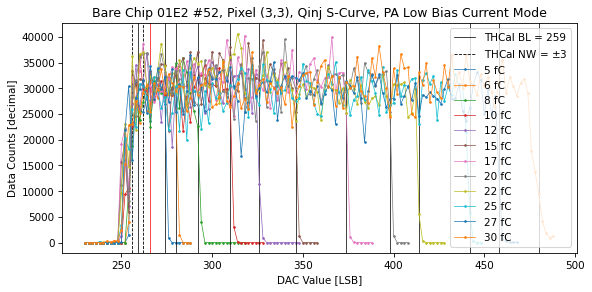

In [96]:
fig = plt.figure(dpi=75, figsize=(8,4))
gs = fig.add_gridspec(len(scan_list),len(scan_list))
u_cl = np.sort(np.unique(col_list))
u_rl = np.sort(np.unique(row_list))
for ri,row in enumerate(u_rl):
    for ci,col in enumerate(u_cl):
        ax0 = fig.add_subplot(gs[len(u_rl)-ri-1,len(u_cl)-ci-1])
        ax0.axvline(BL_map_THCal[(row,col)][15][232], color='k', lw=0.7, label=f"THCal BL = {int(BL_map_THCal[(row,col)][15][232])}")
        ax0.axvline(BL_map_THCal[(row,col)][15][232]+NW_map_THCal[(row,col)][15][232], color='k',ls="--", lw=0.8, label=f"THCal NW = $\pm${int(NW_map_THCal[(row,col)][15][232])}")
        ax0.axvline(BL_map_THCal[(row,col)][15][232]-NW_map_THCal[(row,col)][15][232], color='k',ls="--", lw=0.8)
        ax0.axvline(thresholds[QInj][18], color='r', lw=0.7)
        for QInj in QInjEns:
            tp_idx = turning_point(np.array(list(hit_counts[(row,col)][QInj].values())), thresholds[QInj])
            ax0.axvline(thresholds[QInj][tp_idx], color='k', lw=0.7)
            ax0.plot(thresholds[QInj], hit_counts[(row,col)][QInj].values(), '.-', label=f"{QInj} fC", lw=0.7, markersize=3)
        ax0.set_xlabel("DAC Value [LSB]")
        ax0.set_ylabel("Data Counts [decimal]")
        plt.title(f"Bare Chip 01E2 #52, Pixel ({row},{col}), Qinj S-Curve, PA Low Bias Current Mode")
        # ax0.plot(thresholds[idx_min], np.array(list(hitmap_full_Scurve[row][col][QInj].values()))[idx_min], 'ro')
        # ax0.plot(thresholds[idx_max], np.array(list(hitmap_full_Scurve[row][col][QInj].values()))[idx_max], 'go')
        plt.legend(loc="upper right")
plt.tight_layout()
# plt.savefig("figures/simple_scurve.pdf")
plt.show()

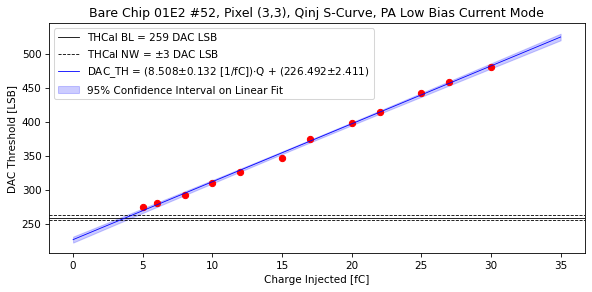

In [80]:
# https://nbviewer.org/github/demotu/BMC/blob/master/notebooks/CurveFitting.ipynb
# https://tomholderness.wordpress.com/2013/01/10/confidence_intervals/
# https://stackoverflow.com/questions/27164114/show-confidence-limits-and-prediction-limits-in-scatter-plot

fig = plt.figure(dpi=75, figsize=(8,4))
gs = fig.add_gridspec(len(scan_list),len(scan_list))
u_cl = np.sort(np.unique(col_list))
u_rl = np.sort(np.unique(row_list))
for ri,row in enumerate(u_rl):
    for ci,col in enumerate(u_cl):
        ax0 = fig.add_subplot(gs[len(u_rl)-ri-1,len(u_cl)-ci-1])
        ax0.axhline(BL_map_THCal[(row,col)][15][232], color='k', lw=0.8, label=f"THCal BL = {int(BL_map_THCal[(row,col)][15][232])} DAC LSB")
        ax0.axhline(BL_map_THCal[(row,col)][15][232]+NW_map_THCal[(row,col)][15][232], color='k',ls="--", lw=0.8, label=f"THCal NW = $\pm${int(NW_map_THCal[(row,col)][15][232])} DAC LSB")
        ax0.axhline(BL_map_THCal[(row,col)][15][232]-NW_map_THCal[(row,col)][15][232], color='k',ls="--", lw=0.8)
        X = []
        Y = []
        for QInj in QInjEns:
            tp_idx = turning_point(np.array(list(hit_counts[(row,col)][QInj].values())), thresholds[QInj])
            ax0.plot(QInj, thresholds[QInj][tp_idx], 'ro')
            X.append(QInj)
            Y.append(thresholds[QInj][tp_idx])
        X = np.array(X)
        Y = np.array(Y)
        (m, b), cov = np.polyfit(X, Y, 1, cov = True)
        n = Y.size
        Yfit = np.polyval((m,b), X)
        errorbars = np.sqrt(np.diag(cov))
        x_range = np.linspace(0, 35, 100)
        y_est = b + m*x_range
        resid = Y - Yfit
        s_err = np.sqrt(np.sum(resid**2)/(n - 2))
        t = stats.t.ppf(0.95, n - 2)
        ci = t * s_err * np.sqrt(    1/n + (X - np.mean(X))**2/np.sum((X-np.mean(X))**2)) # confidence interval
        pi = t * s_err * np.sqrt(1 + 1/n + (X - np.mean(X))**2/np.sum((X-np.mean(X))**2)) # prediction interval
        # cip= t * s_err * np.sqrt(    1/n + (X - np.mean(X))**2/(np.sum((X)**2)-n*np.sum((np.mean(X))**2)))
        ci2= t * s_err * np.sqrt(    1/n + (x_range - np.mean(X))**2/(np.sum((X)**2)-n*np.sum((np.mean(X))**2)))
        
        ax0.plot(x_range, y_est, 'b-', lw=-.8, label=f"DAC_TH = ({m:.3f}$\pm${errorbars[0]:.3f} [1/fC])$\cdot$Q + ({b:.3f}$\pm${errorbars[1]:.3f})")
        plt.fill_between(x_range, y_est+ci2, y_est-ci2, color='b',alpha=0.2, label="95% Confidence Interval on Linear Fit")
        ax0.set_xlabel("Charge Injected [fC]")
        ax0.set_ylabel("DAC Threshold [LSB]")
        plt.title(f"Bare Chip 01E2 #52, Pixel ({row},{col}), Qinj S-Curve, PA Low Bias Current Mode")
        plt.legend(loc="upper left")
plt.tight_layout()
# plt.savefig("figures/q_vs_dac_scurve.pdf")
# plt.savefig("figures/q_vs_dac_scurve.png")
plt.show()

## Make np arrays for training

In [109]:
toa_ = []
tot_ = []
cal_ = []
qin_ = []
del_ = []
root = '../ETROC-Data'
file_pattern = "*translated*.dat"
for ri,row in enumerate([3]):
    for ci,col in enumerate([3]):
        for QInj in QInjEns[:-2]:
            tp_idx = turning_point(np.array(list(hit_counts[(row,col)][QInj].values())), thresholds[QInj])
            # if(QInj==5):
            #     toa_.extend(np.array(list(TOA_mean[(row,col)][QInj].values()))[15:tp_idx-2])
            #     tot_.extend(np.array(list(TOT_mean[(row,col)][QInj].values()))[15:tp_idx-2])
            #     cal_.extend(np.array(list(CAL_mean[(row,col)][QInj].values()))[15:tp_idx-2])
            #     qin_.extend(np.full_like(np.array(list(TOA_mean[(row,col)][QInj].values()))[15:tp_idx-2], QInj))
            #     del_.extend(thresholds[QInj][15:tp_idx-2])
            # else:
            #     toa_.extend(np.array(list(TOA_mean[(row,col)][QInj].values()))[15:tp_idx-0])
            #     tot_.extend(np.array(list(TOT_mean[(row,col)][QInj].values()))[15:tp_idx-0])
            #     cal_.extend(np.array(list(CAL_mean[(row,col)][QInj].values()))[15:tp_idx-0])
            #     qin_.extend(np.full_like(np.array(list(TOA_mean[(row,col)][QInj].values()))[15:tp_idx-0], QInj))
            #     del_.extend(thresholds[QInj][15:tp_idx-0])
            for idx_DAC,DAC in enumerate(thresholds[QInj]):
                path_pattern = f"*2023-06-13_Array_Test_Results/E2_testing_VRef_SCurve_Pixel_C{col}_R{row}_QInj_{QInj}_Threshold_{DAC}"
                file_list = []
                for path, subdirs, files in os.walk(root):
                    if not fnmatch(path, path_pattern): continue
                    for name in files:
                        pass
                        if fnmatch(name, file_pattern):
                            file_list.append(os.path.join(path, name))
                            print(file_list[-1])
                current_bcid = -1
                previous_bcid = -1
                total_files = len(file_list)
                for file_index, file_name in enumerate(file_list):
                    print(f"{file_index+1}/{total_files}")
                    with open(file_name) as infile:
                        for line in infile:
                            text_list = line.split()
                            if(text_list[2]=="HEADER"): current_bcid = int(text_list[8])
                            elif(text_list[2]=="TRAILER"): previous_bcid = current_bcid
                            # if(previous_bcid==-1 or (current_bcid-previous_bcid==68 if current_bcid>=previous_bcid else current_bcid+3564-previous_bcid==68)): continue
                            if text_list[2]!="DATA": continue
                            c_running = int(text_list[6])
                            r_running = int(text_list[8])
                            if(c_running!=col or r_running!=row): continue
                            TOA = int(text_list[10])
                            TOT = int(text_list[12])
                            CAL = int(text_list[14])
                            if(CAL>200 or CAL<100): continue
                            if(idx_DAC>=18 and idx_DAC<len(thresholds[QInj])):
                                toa_.append(TOA)
                                tot_.append(TOT)
                                cal_.append(CAL)
                                qin_.append(QInj)
                                del_.append(DAC)                
toa_ = np.array(toa_)
tot_ = np.array(tot_)
cal_ = np.array(cal_)
qin_ = np.array(qin_)
del_ = np.array(del_)

../ETROC-Data/2023-06-13_Array_Test_Results/E2_testing_VRef_SCurve_Pixel_C3_R3_QInj_5_Threshold_230/TDC_Data_translated_0.dat
1/1
../ETROC-Data/2023-06-13_Array_Test_Results/E2_testing_VRef_SCurve_Pixel_C3_R3_QInj_5_Threshold_232/TDC_Data_translated_0.dat
1/1
../ETROC-Data/2023-06-13_Array_Test_Results/E2_testing_VRef_SCurve_Pixel_C3_R3_QInj_5_Threshold_234/TDC_Data_translated_0.dat
1/1
../ETROC-Data/2023-06-13_Array_Test_Results/E2_testing_VRef_SCurve_Pixel_C3_R3_QInj_5_Threshold_236/TDC_Data_translated_0.dat
1/1
../ETROC-Data/2023-06-13_Array_Test_Results/E2_testing_VRef_SCurve_Pixel_C3_R3_QInj_5_Threshold_238/TDC_Data_translated_0.dat
1/1
../ETROC-Data/2023-06-13_Array_Test_Results/E2_testing_VRef_SCurve_Pixel_C3_R3_QInj_5_Threshold_240/TDC_Data_translated_0.dat
1/1
../ETROC-Data/2023-06-13_Array_Test_Results/E2_testing_VRef_SCurve_Pixel_C3_R3_QInj_5_Threshold_242/TDC_Data_translated_0.dat
1/1
../ETROC-Data/2023-06-13_Array_Test_Results/E2_testing_VRef_SCurve_Pixel_C3_R3_QInj_5_Thre

## Training Imports

In [110]:
import tensorflow as tf
from tensorflow.keras import backend as K
from tensorflow.keras.losses import binary_crossentropy
from tensorflow.keras.models import Model, Sequential
import tensorflow.keras.layers as layers
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense, Bidirectional, Dropout, BatchNormalization, Masking, Concatenate
from tensorflow.keras.layers import LSTM, Input, Lambda, Permute, Activation, RepeatVector, Flatten, Dot, TimeDistributed
from tensorflow.keras.preprocessing import sequence
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.wrappers.scikit_learn import KerasRegressor
from tensorflow.keras.utils import plot_model, to_categorical
import tensorflow_decision_forests as tfdf
import pandas as pd
from scipy.optimize import curve_fit
from scipy.stats import binned_statistic
from sklearn.model_selection import train_test_split, cross_val_score, KFold
from sklearn.utils import class_weight, shuffle
from sklearn.preprocessing import label_binarize, StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import roc_auc_score, roc_curve, auc
from sklearn.decomposition import PCA

## Regression NN

In [128]:
def return_dense_model(numpars=1):
    input  = Input(shape=(numpars,), name='input')
    dense1 = Dense(128, activation='relu', name='dense1')(input)
    dense2 = Dense(128, activation='relu', name='dense2')(dense1)
    # dense3 = Dense(128, activation='relu', name='dense3')(dense2)
    output = Dense(1, activation='linear', name='prob')(dense2)
    model  = Model(inputs=[input], outputs=output, name="simple_dense_NN")
    model.compile(loss='mse', optimizer='adam')
    return model

In [129]:
model = return_dense_model(numpars=2)

In [130]:
checkpointer = ModelCheckpoint('models/weights.hdf5', verbose=1, save_best_only=True,monitor="val_loss")
term = tf.keras.callbacks.TerminateOnNaN()
escb = tf.keras.callbacks.EarlyStopping(monitor="val_loss", patience=15, verbose=0)
history = model.fit(
    np.stack([(3125/cal_)*tot_,del_],axis=-1),
    qin_,
    epochs=100,
    verbose=1,
    validation_split = 0.3,
    callbacks=[checkpointer,term,escb],
    batch_size=10000)

Epoch 1/100
864/870 [============================>.] - ETA: 0s - loss: 21.4355
Epoch 1: val_loss improved from inf to 38.59837, saving model to models/weights.hdf5
870/870 [==============================] - 6s 6ms/step - loss: 21.3891 - val_loss: 38.5984
Epoch 2/100
869/870 [============================>.] - ETA: 0s - loss: 14.6446
Epoch 2: val_loss improved from 38.59837 to 22.70874, saving model to models/weights.hdf5
870/870 [==============================] - 5s 6ms/step - loss: 14.6458 - val_loss: 22.7087
Epoch 3/100
867/870 [============================>.] - ETA: 0s - loss: 14.8130
Epoch 3: val_loss did not improve from 22.70874
870/870 [==============================] - 5s 6ms/step - loss: 14.8085 - val_loss: 41.4382
Epoch 4/100
869/870 [============================>.] - ETA: 0s - loss: 14.2434
Epoch 4: val_loss did not improve from 22.70874
870/870 [==============================] - 5s 6ms/step - loss: 14.2432 - val_loss: 33.1591
Epoch 5/100
869/870 [============================

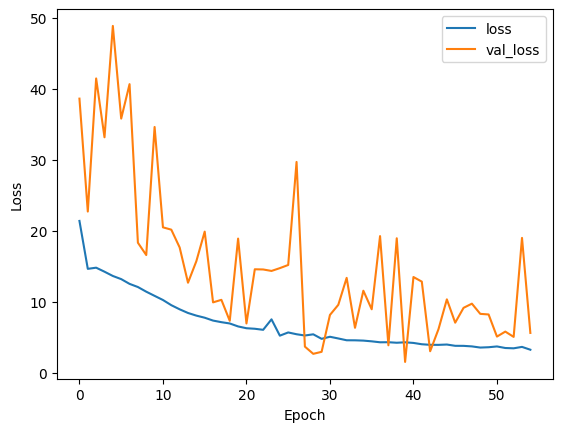

In [131]:
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label='val_loss')
# plt.ylim([0, 10])
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [135]:
test_size = 70
# test_TOT = np.linspace(10,75,test_size)
test_TOT = np.linspace(300,1500,test_size)
test_DAC = np.linspace(250,485,test_size)
test_TOT_width = (1500-300)/test_size
test_DAC_width = (485-250)/test_size
DACxx, TOTyy = np.meshgrid(test_DAC, test_TOT)
model.load_weights('models/weights.hdf5')
Qpred = model.predict(np.stack([TOTyy.flatten(),DACxx.flatten()], axis=-1))

154/154 [==============================] - 0s 317us/step


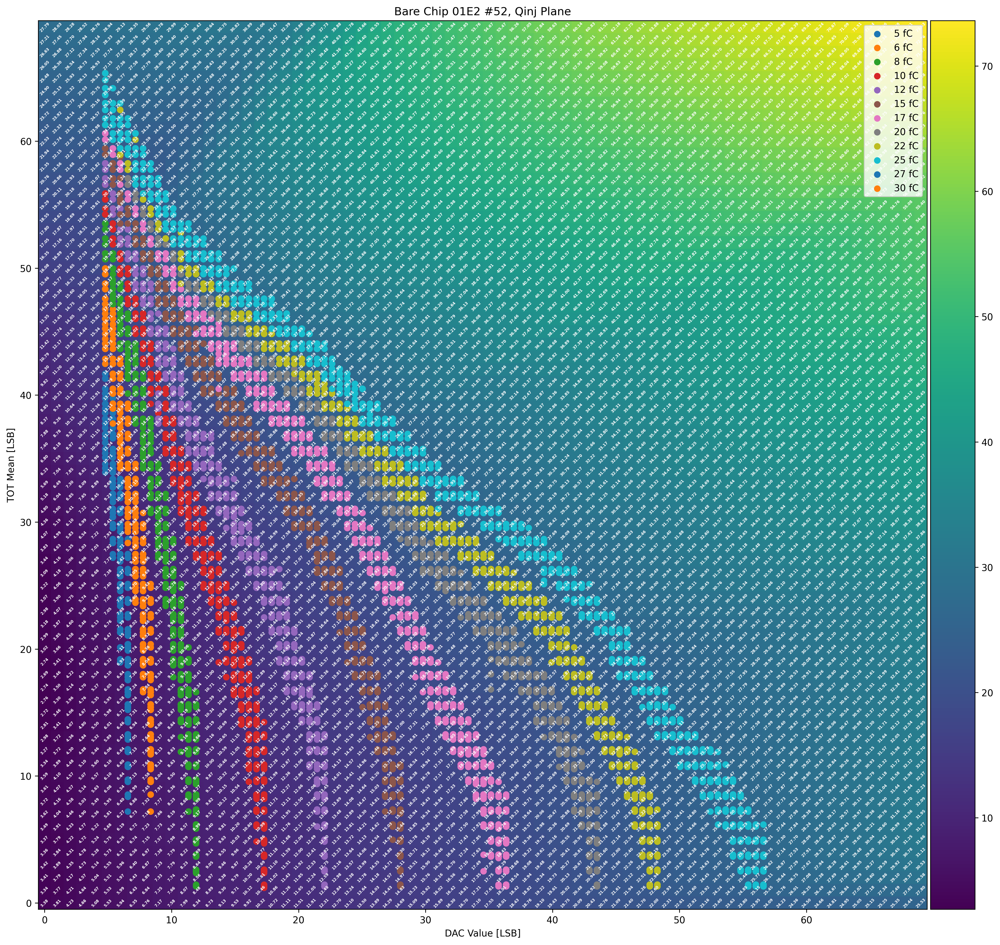

In [139]:
fig = plt.figure(dpi=300, figsize=(15,15))
gs = fig.add_gridspec(1,1)

ax0 = fig.add_subplot(gs[0,0])
ax0.set_title("Bare Chip 01E2 #52, Qinj Plane")
img0 = ax0.imshow((Qpred.reshape((test_size,test_size))))
# ax0.invert_xaxis()
for QInj in QInjEns:
    tp_idx = turning_point(np.array(list(hit_counts[(row,col)][QInj].values())), thresholds[QInj])
    # ax0.scatter(-1*((250-thresholds[QInj][15:tp_idx-2])/(test_DAC_width)), -1*((10-np.array(list(TOT_mean[(row,col)][QInj].values()))[15:tp_idx-2])/(test_TOT_width)), label=f"{QInj} fC")
    selection = (del_<thresholds[QInj][tp_idx]) & (del_>=thresholds[QInj][18]) & (qin_==QInj)
    ax0.scatter(-1*((250-del_[selection][::4])/(test_DAC_width)), -1*((300-((3125/cal_)*tot_)[selection][::4])/(test_TOT_width)), label=f"{QInj} fC")
plt.legend()
ax0.invert_yaxis()
# plt.xticks(range(test_size), np.linspace(250,485,test_size), rotation='vertical')
# plt.yticks(range(test_size), np.linspace(10,75,test_size))
ax0.set_xlabel("DAC Value [LSB]")
ax0.set_ylabel("TOT Mean [LSB]")
divider = make_axes_locatable(ax0)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(img0, cax=cax, orientation='vertical')
for x in range(test_size):
    for y in range(test_size):
        ax0.text(x, y, f"{Qpred.reshape((test_size,test_size)).T[x,y]:.2f}", ha="center", va="center", fontweight="bold", c="white", size=4, rotation=45)
plt.tight_layout()
plt.savefig("figures/NN_output.pdf")
plt.show()

## Boosted Tree

In [162]:
train_dataset = tf.data.Dataset.from_tensor_slices((np.stack([tot_,del_],axis=-1), qin_))
# train_dataset = train_dataset.shuffle()
# test_dataset = tf.data.Dataset.from_tensor_slices((test_examples, test_labels))

In [163]:
BATCH_SIZE = 1000
train_dataset = train_dataset.batch(BATCH_SIZE)

In [175]:
pd_train_dataset = pd.DataFrame({
    "tot": (3125/cal_)*tot_,
    "delay": del_,
    "label":qin_
})
tf_train_dataset = tfdf.keras.pd_dataframe_to_tf_dataset(pd_train_dataset, label="label",task = tfdf.keras.Task.REGRESSION)

In [114]:
%%time
# Train a model with default hyper-parameters
# tuned_model = tfdf.keras.GradientBoostedTreesModel(task = tfdf.keras.Task.REGRESSION,verbose=1)
tuned_model = tfdf.keras.RandomForestModel(task = tfdf.keras.Task.REGRESSION,verbose=1)
history = tuned_model.fit(tf_train_dataset)
# history = tuned_model.fit({'0':tot_,'1':del_}, qin_)

Use /var/folders/h9/jf9lvlw131x_11_x8syn64cm0000gr/T/tmpu1v7qiww as temporary training directory
Reading training dataset...
Training dataset read in 0:00:09.074080. Found 12418214 examples.
Training model...


[INFO 23-06-14 11:34:45.3318 CDT kernel.cc:1242] Loading model from path /var/folders/h9/jf9lvlw131x_11_x8syn64cm0000gr/T/tmpu1v7qiww/model/ with prefix c83b7841a9c1426f


Model trained in 0:03:04.496749
Compiling model...
Model compiled.
CPU times: user 23min 50s, sys: 32.1 s, total: 24min 22s
Wall time: 3min 13s


[INFO 23-06-14 11:34:45.8454 CDT decision_forest.cc:660] Model loaded with 300 root(s), 469334 node(s), and 2 input feature(s).
[INFO 23-06-14 11:34:45.8455 CDT abstract_model.cc:1312] Engine "RandomForestOptPred" built
[INFO 23-06-14 11:34:45.8455 CDT kernel.cc:1074] Use fast generic engine


In [115]:
history.history

{'num_examples': [12418214], 'rmse': [0.5069679214958712]}

In [176]:
%%time

# Create a Random Search tuner with 50 trials and automatic hp configuration.
tuner = tfdf.tuner.RandomSearch(num_trials=10, use_predefined_hps=True)

# Define and train the model.
# tuned_model = tfdf.keras.GradientBoostedTreesModel(task = tfdf.keras.Task.REGRESSION,tuner=tuner)
tuned_model = tfdf.keras.RandomForestModel(task = tfdf.keras.Task.REGRESSION,tuner=tuner)
tuned_model.fit(tf_train_dataset, verbose=1, batch_size=10000)

Use /var/folders/h9/jf9lvlw131x_11_x8syn64cm0000gr/T/tmpw86nasi6 as temporary training directory


Reading training dataset...


Training dataset read in 0:00:08.920200. Found 12418214 examples.
Training model...


[INFO 23-06-14 15:33:17.1982 CDT kernel.cc:1242] Loading model from path /var/folders/h9/jf9lvlw131x_11_x8syn64cm0000gr/T/tmpw86nasi6/model/ with prefix ad198f4beeba451c


Model trained in 1:54:22.857457
Compiling model...


[INFO 23-06-14 15:33:17.7651 CDT decision_forest.cc:660] Model loaded with 300 root(s), 469882 node(s), and 2 input feature(s).
[INFO 23-06-14 15:33:17.7652 CDT abstract_model.cc:1312] Engine "RandomForestGeneric" built
[INFO 23-06-14 15:33:17.7652 CDT kernel.cc:1074] Use fast generic engine


Model compiled.


CPU times: user 11h 34min 11s, sys: 46min 39s, total: 12h 20min 50s
Wall time: 1h 54min 32s


In [177]:
# Evaluate the model on the test dataset.
tuned_model.compile(metrics=["mae","mse"])
evaluation = tuned_model.evaluate(tf_train_dataset, return_dict=True, batch_size=10000)

print(evaluation)
print()
print(f"MSE: {evaluation['mae']}")
print(f"MSE: {evaluation['mse']}")
print(f"RMSE: {np.sqrt(evaluation['mse'])}")

12419/12419 [==============================] - 452s 36ms/step - loss: 0.0000e+00 - mae: 0.1249 - mse: 0.2569
{'loss': 0.0, 'mae': 0.12486757338047028, 'mse': 0.25688791275024414}

MSE: 0.12486757338047028
MSE: 0.25688791275024414
RMSE: 0.5068411119377


In [178]:
tuned_model.save("models/bdt_model")

INFO:tensorflow:Assets written to: models/bdt_model/assets


INFO:tensorflow:Assets written to: models/bdt_model/assets


In [179]:
# Display the tuning logs.
tuning_logs = tuned_model.make_inspector().tuning_logs()
tuning_logs.head()

,score,evaluation_time,best,split_axis,sparse_oblique_projection_density_factor,sparse_oblique_normalization,sparse_oblique_weights,categorical_algorithm,winner_take_all,max_depth,min_examples
0,-0.507020,4296.692664,False,SPARSE_OBLIQUE,1.0,MIN_MAX,CONTINUOUS,CART,true,20,10
1,-0.507110,4396.655925,False,SPARSE_OBLIQUE,1.0,NONE,CONTINUOUS,RANDOM,true,25,40
2,-1.045448,5101.509658,False,SPARSE_OBLIQUE,5.0,MIN_MAX,BINARY,CART,true,12,40
3,-0.515496,5341.063781,False,SPARSE_OBLIQUE,4.0,MIN_MAX,CONTINUOUS,RANDOM,true,16,10
4,-0.516074,5349.903973,False,SPARSE_OBLIQUE,5.0,MIN_MAX,CONTINUOUS,CART,true,16,1


In [180]:
# Best hyper-parameters.
tuning_logs[tuning_logs.best].iloc[0]

score                                            -0.506912
evaluation_time                                5873.050179
best                                                  True
split_axis                                  SPARSE_OBLIQUE
sparse_oblique_projection_density_factor               3.0
sparse_oblique_normalization                          NONE
sparse_oblique_weights                          CONTINUOUS
categorical_algorithm                                 CART
winner_take_all                                       true
max_depth                                               30
min_examples                                             2
Name: 8, dtype: object

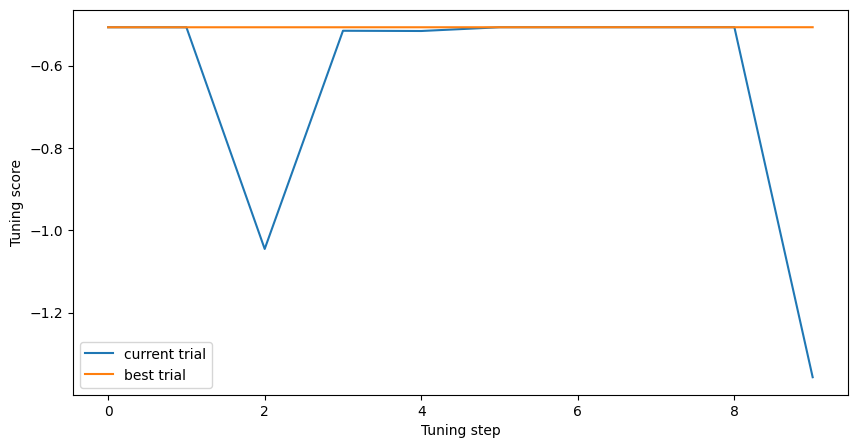

In [181]:
plt.figure(figsize=(10, 5))
plt.plot(tuning_logs["score"], label="current trial")
plt.plot(tuning_logs["score"].cummax(), label="best trial")
plt.xlabel("Tuning step")
plt.ylabel("Tuning score")
plt.legend()
plt.show()

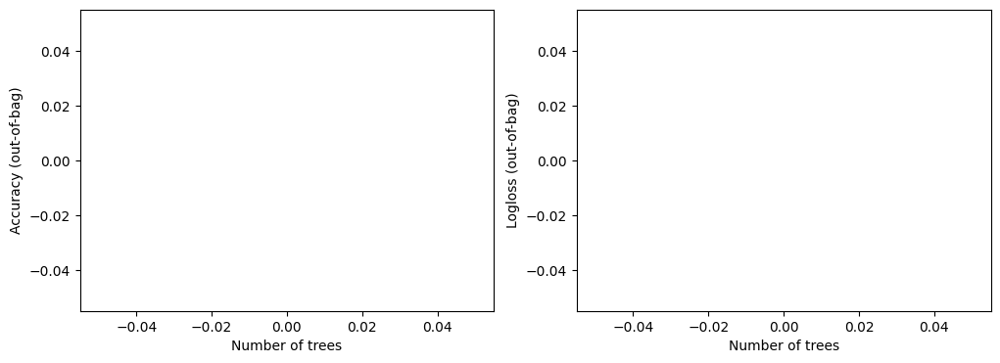

In [182]:
logs = tuned_model.make_inspector().training_logs()

plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot([log.num_trees for log in logs], [log.evaluation.accuracy for log in logs])
plt.xlabel("Number of trees")
plt.ylabel("Accuracy (out-of-bag)")

plt.subplot(1, 2, 2)
plt.plot([log.num_trees for log in logs], [log.evaluation.loss for log in logs])
plt.xlabel("Number of trees")
plt.ylabel("Logloss (out-of-bag)")

plt.show()

In [183]:
test_size = 70
# test_TOT = np.linspace(10,75,test_size)
test_TOT = np.linspace(300,1500,test_size)
test_DAC = np.linspace(250,485,test_size)
# test_TOT_width = (75-10)/test_size
test_TOT_width = (1500-300)/test_size
test_DAC_width = (485-250)/test_size
DACxx, TOTyy = np.meshgrid(test_DAC, test_TOT)
# tuned_model.load_weights('models/bdt_model')
# tuned_test_model = tfdf.keras.GradientBoostedTreesModel(task = tfdf.keras.Task.REGRESSION,verbose=1)
# tuned_test_model.load_weights('models/bdt_model.hdf5')
# Qpred = tuned_model.predict(np.stack([TOTyy.flatten(),DACxx.flatten()], axis=-1))

pd_eval_dataset = pd.DataFrame({
    "tot": TOTyy.flatten(),
    "delay": DACxx.flatten(),
})
tf_eval_dataset = tfdf.keras.pd_dataframe_to_tf_dataset(pd_eval_dataset,task = tfdf.keras.Task.REGRESSION)
Qpred = tuned_model.predict(tf_eval_dataset)

5/5 [==============================] - 0s 44ms/step


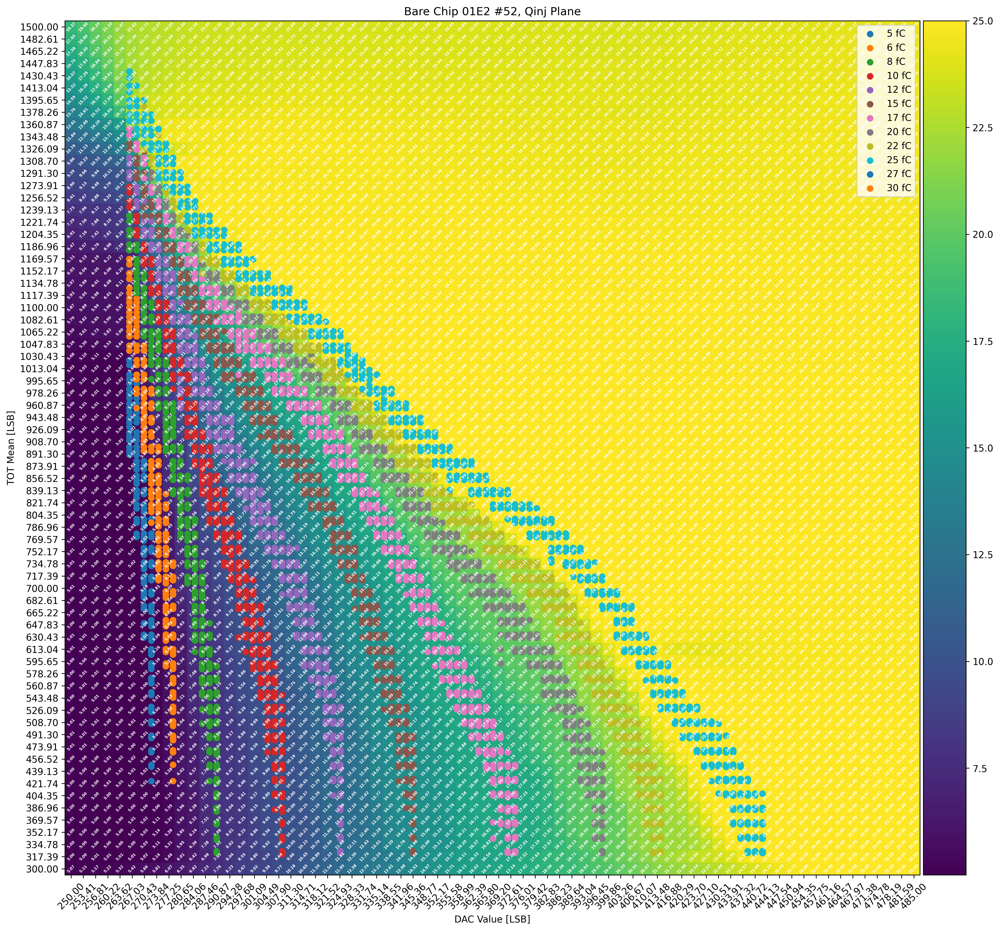

In [184]:
fig = plt.figure(dpi=300, figsize=(15,15))
gs = fig.add_gridspec(1,1)

ax0 = fig.add_subplot(gs[0,0])
ax0.set_title("Bare Chip 01E2 #52, Qinj Plane")
img0 = ax0.imshow((Qpred.reshape((test_size,test_size))))
# ax0.invert_xaxis()
for QInj in QInjEns:
    tp_idx = turning_point(np.array(list(hit_counts[(row,col)][QInj].values())), thresholds[QInj])
    # ax0.scatter(-1*((250-thresholds[QInj][15:tp_idx-2])/(test_DAC_width)), -1*((10-np.array(list(TOT_mean[(row,col)][QInj].values()))[15:tp_idx-2])/(test_TOT_width)), label=f"{QInj} fC")
    selection = (del_<thresholds[QInj][tp_idx]) & (del_>=thresholds[QInj][18]) & (qin_==QInj)
    ax0.scatter(-1*((250-del_[selection][::4])/(test_DAC_width)), -1*((300-((3125/cal_)*tot_)[selection][::4])/(test_TOT_width)), label=f"{QInj} fC")
plt.legend()
ax0.invert_yaxis()
plt.xticks(range(test_size), [f'{fn:.2f}' for fn in test_DAC], rotation=45)
plt.yticks(range(test_size), [f'{fn:.2f}' for fn in test_TOT])
ax0.set_xlabel("DAC Value [LSB]")
ax0.set_ylabel("TOT Mean [LSB]")
divider = make_axes_locatable(ax0)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(img0, cax=cax, orientation='vertical')
for x in range(test_size):
    for y in range(test_size):
        ax0.text(x, y, f"{Qpred.reshape((test_size,test_size)).T[x,y]:.2f}", ha="center", va="center", fontweight="bold", c="white", size=4, rotation=45)
plt.tight_layout()
plt.savefig("figures/BDT_output.pdf")
plt.show()

# BDT learning the TOA plane?

In [ ]:
test_size = 70
# test_TOT = np.linspace(10,75,test_size)
test_TOT = np.linspace(300,1500,test_size)
test_TOA = np.linspace(4000,5000,test_size)
test_DAC = np.linspace(250,485,test_size)
test_TOT_width = (1500-300)/test_size
test_DAC_width = (485-250)/test_size
DACxx, TOTyy = np.meshgrid(test_DAC, test_TOT)
model.load_weights('models/weights.hdf5')
# Qpred = model.predict(np.stack([TOTyy.flatten(),DACxx.flatten()], axis=-1))

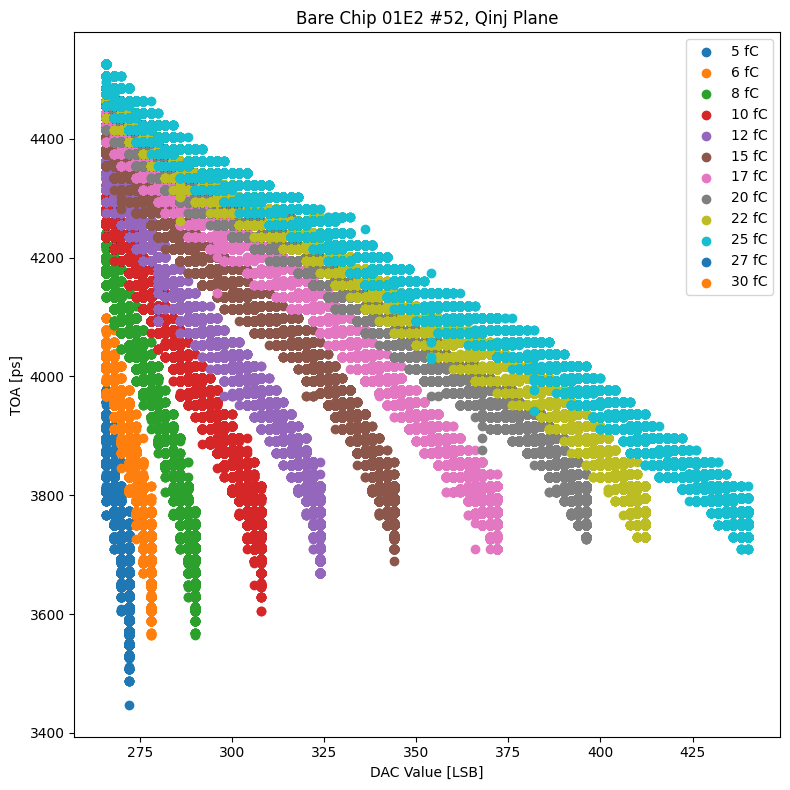

In [188]:
fig = plt.figure(dpi=100, figsize=(8,8))
gs = fig.add_gridspec(1,1)
ax0 = fig.add_subplot(gs[0,0])
ax0.set_title("Bare Chip 01E2 #52, Qinj Plane")
for QInj in QInjEns:
    tp_idx = turning_point(np.array(list(hit_counts[(row,col)][QInj].values())), thresholds[QInj])
    selection = (del_<thresholds[QInj][tp_idx]) & (del_>=thresholds[QInj][18]) & (qin_==QInj)
    ax0.scatter(((del_[selection][::4])), ((((3125/cal_)*toa_)[selection][::4])), label=f"{QInj} fC")
plt.legend()
ax0.set_xlabel("DAC Value [LSB]")
ax0.set_ylabel("TOA [ps]")
plt.tight_layout()
# plt.savefig("figures/BDT_output.pdf")
plt.show()

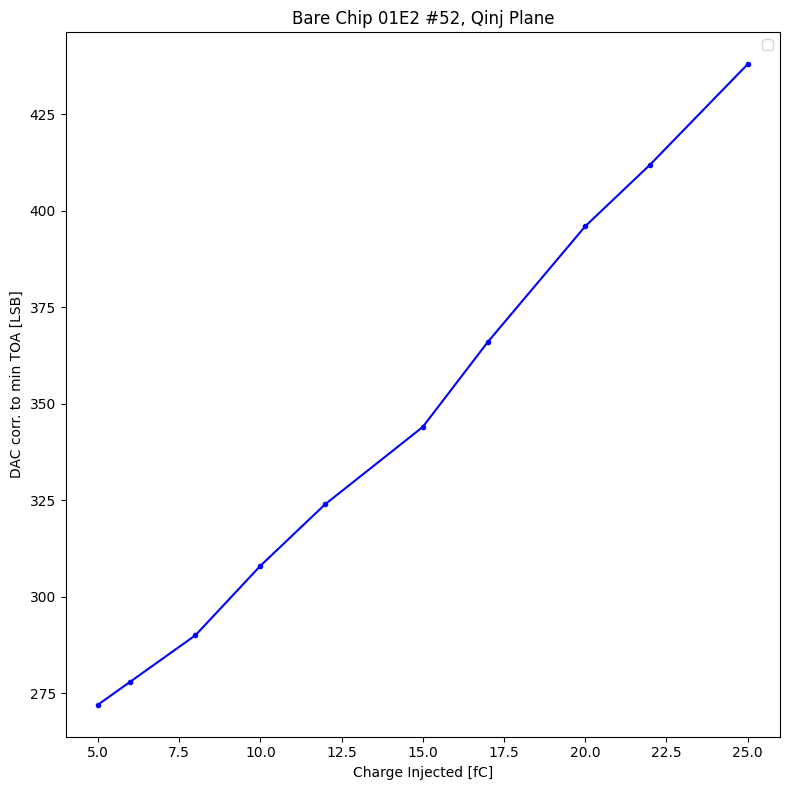

In [203]:
fig = plt.figure(dpi=100, figsize=(8,8))
gs = fig.add_gridspec(1,1)
ax0 = fig.add_subplot(gs[0,0])
ax0.set_title("Bare Chip 01E2 #52, Qinj Plane")
X_dac = []
Y_toa = []
Z_qin = []
for QInj in QInjEns[:-2]:
    tp_idx = turning_point(np.array(list(hit_counts[(row,col)][QInj].values())), thresholds[QInj])
    selection = (del_<thresholds[QInj][tp_idx]) & (del_>=thresholds[QInj][18]) & (qin_==QInj)
    min_toa_idx = np.argmin(((3125/cal_)*toa_)[selection])
    X_dac.append((del_[selection])[min_toa_idx])
    Y_toa.append((((3125/cal_)*toa_)[selection])[min_toa_idx])
    Z_qin.append(QInj)
ax0.plot(Z_qin, X_dac, 'b.-')
plt.legend()
ax0.set_xlabel("Charge Injected [fC]")
ax0.set_ylabel("DAC corr. to min TOA [LSB]")
plt.tight_layout()
# plt.savefig("figures/BDT_output.pdf")
plt.show()

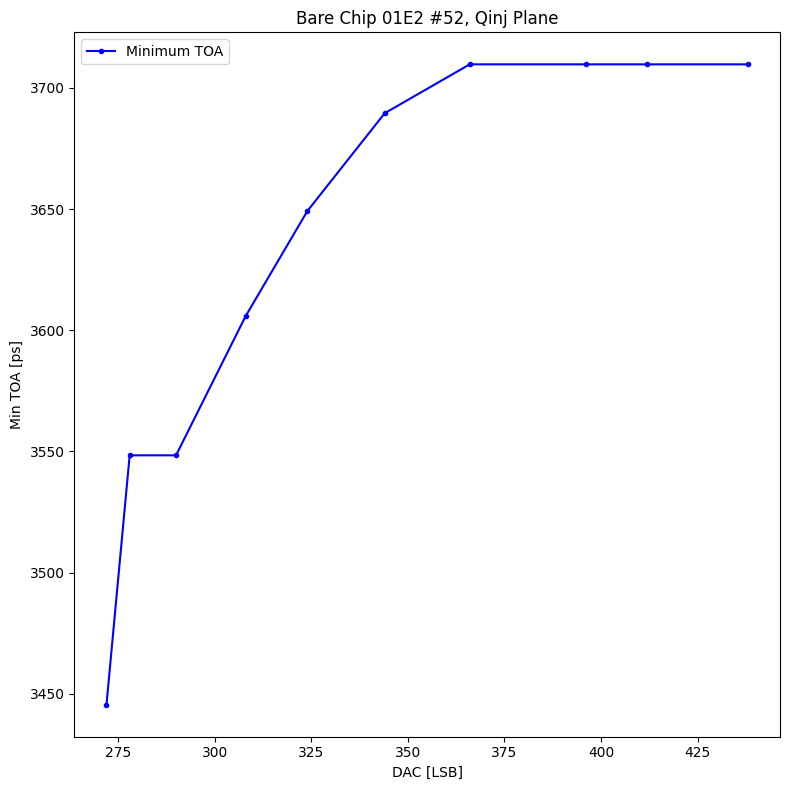

In [201]:
fig = plt.figure(dpi=100, figsize=(8,8))
gs = fig.add_gridspec(1,1)
ax0 = fig.add_subplot(gs[0,0])
ax0.set_title("Bare Chip 01E2 #52, Qinj Plane")
X_dac = []
Y_toa = []
Z_qin = []
for QInj in QInjEns[:-2]:
    tp_idx = turning_point(np.array(list(hit_counts[(row,col)][QInj].values())), thresholds[QInj])
    selection = (del_<thresholds[QInj][tp_idx]) & (del_>=thresholds[QInj][18]) & (qin_==QInj)
    min_toa_idx = np.argmin(((3125/cal_)*toa_)[selection])
    X_dac.append((del_[selection])[min_toa_idx])
    Y_toa.append((((3125/cal_)*toa_)[selection])[min_toa_idx])
    Z_qin.append(QInj)
ax0.plot(X_dac, Y_toa, 'b.-', label="Minimum TOA")
plt.legend()
ax0.set_xlabel("DAC [LSB]")
ax0.set_ylabel("Min TOA [ps]")
plt.tight_layout()
# plt.savefig("figures/BDT_output.pdf")
plt.show()

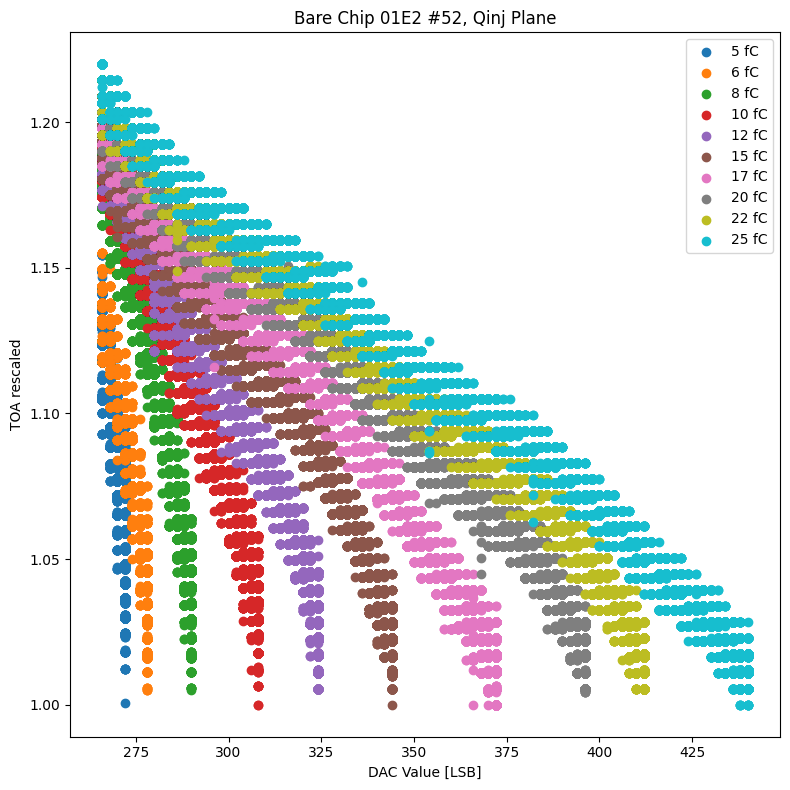

In [205]:
fig = plt.figure(dpi=100, figsize=(8,8))
gs = fig.add_gridspec(1,1)
ax0 = fig.add_subplot(gs[0,0])
ax0.set_title("Bare Chip 01E2 #52, Qinj Plane")
for QInj in QInjEns[:-2]:
    tp_idx = turning_point(np.array(list(hit_counts[(row,col)][QInj].values())), thresholds[QInj])
    selection = (del_<thresholds[QInj][tp_idx]) & (del_>=thresholds[QInj][18]) & (qin_==QInj)
    min_toa_idx = np.argmin(((3125/cal_)*toa_)[selection])
    ax0.scatter(((del_[selection][::4])), ( (((3125/cal_)*toa_)[selection])/((((3125/cal_)*toa_)[selection])[min_toa_idx]) )[::4], label=f"{QInj} fC")
plt.legend()
ax0.set_xlabel("DAC Value [LSB]")
ax0.set_ylabel("TOA rescaled")
plt.tight_layout()
# plt.savefig("figures/BDT_output.pdf")
plt.show()

## Study the BDT

In [ ]:
import os
import math
import dtreeviz
from IPython import display
# avoid "Arial font not found warnings"
import logging
logging.getLogger('matplotlib.font_manager').setLevel(level=logging.CRITICAL)
display.set_matplotlib_formats('retina') # generate hires plots
np.random.seed(1234)  # reproducible plots/data for explanatory reasons

In [ ]:
# Let's check the versions:
tfdf.__version__, dtreeviz.__version__  # want dtreeviz >= 2.2.0

In [ ]:
model_features = [f.name for f in tuned_model.make_inspector().features()]
print(model_features)
# train_dataset = tf.data.Dataset.from_tensor_slices((np.stack([tot_,del_],axis=-1), qin_))
viz_rmodel = dtreeviz.model(tuned_model, tree_index=3,
                           X_train=pd_train_dataset[model_features],
                           y_train=pd_train_dataset["label"],
                           feature_names=model_features,
                           target_name='label')

In [ ]:
viz_rmodel.view(scale=1.2)

## TOA TOT CAL plots vs DAC

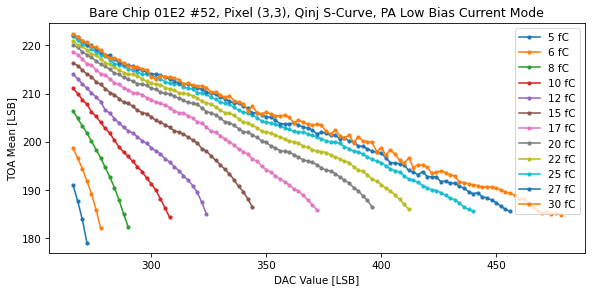

In [103]:
fig = plt.figure(dpi=75, figsize=(8,4))
gs = fig.add_gridspec(len(scan_list),len(scan_list))
u_cl = np.sort(np.unique(col_list))
u_rl = np.sort(np.unique(row_list))
for ri,row in enumerate(u_rl):
    for ci,col in enumerate(u_cl):
        ax0 = fig.add_subplot(gs[len(u_rl)-ri-1,len(u_cl)-ci-1])
        for QInj in QInjEns:
            tp_idx = turning_point(np.array(list(hit_counts[(row,col)][QInj].values())), thresholds[QInj])
            ax0.plot(thresholds[QInj][18:tp_idx-0], np.array(list(TOA_mean[(row,col)][QInj].values()))[18:tp_idx-0], '.-', label=f"{QInj} fC")
        ax0.set_xlabel("DAC Value [LSB]")
        ax0.set_ylabel("TOA Mean [LSB]")
        plt.title(f"Bare Chip 01E2 #52, Pixel ({row},{col}), Qinj S-Curve, PA Low Bias Current Mode")
        plt.legend(loc="upper right")
plt.tight_layout()
# plt.savefig("figures/toa_mean_scurve.pdf")
plt.show()

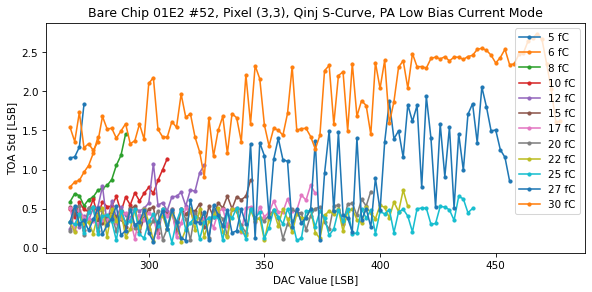

In [104]:
fig = plt.figure(dpi=75, figsize=(8,4))
gs = fig.add_gridspec(len(scan_list),len(scan_list))
u_cl = np.sort(np.unique(col_list))
u_rl = np.sort(np.unique(row_list))
for ri,row in enumerate(u_rl):
    for ci,col in enumerate(u_cl):
        ax0 = fig.add_subplot(gs[len(u_rl)-ri-1,len(u_cl)-ci-1])
        X = []
        Y = []
        for QInj in QInjEns:
            tp_idx = turning_point(np.array(list(hit_counts[(row,col)][QInj].values())), thresholds[QInj])
            ax0.plot(thresholds[QInj][18:tp_idx-0], np.array(list(TOA_std[(row,col)][QInj].values()))[18:tp_idx-0], '.-', label=f"{QInj} fC")
            X.append(QInj)
            Y.append(thresholds[QInj][tp_idx])
        X = np.array(X)
        Y = np.array(Y)
        ax0.set_xlabel("DAC Value [LSB]")
        ax0.set_ylabel("TOA Std [LSB]")
        plt.title(f"Bare Chip 01E2 #52, Pixel ({row},{col}), Qinj S-Curve, PA Low Bias Current Mode")
        plt.legend(loc="upper right")
plt.tight_layout()
# plt.savefig("figures/ta_std_scurve.pdf")
plt.show()

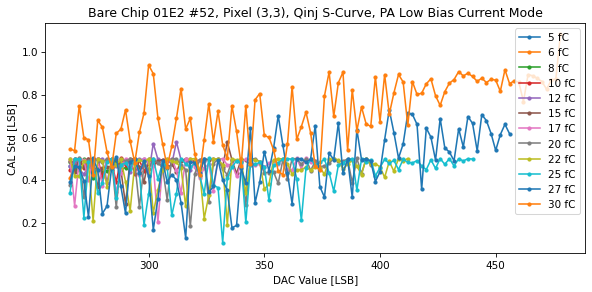

In [105]:
fig = plt.figure(dpi=75, figsize=(8,4))
gs = fig.add_gridspec(len(scan_list),len(scan_list))
u_cl = np.sort(np.unique(col_list))
u_rl = np.sort(np.unique(row_list))
for ri,row in enumerate(u_rl):
    for ci,col in enumerate(u_cl):
        ax0 = fig.add_subplot(gs[len(u_rl)-ri-1,len(u_cl)-ci-1])
        X = []
        Y = []
        for QInj in QInjEns[:]:
            tp_idx = turning_point(np.array(list(hit_counts[(row,col)][QInj].values())), thresholds[QInj])
            ax0.plot(thresholds[QInj][18:tp_idx-0], np.array(list(CAL_std[(row,col)][QInj].values()))[18:tp_idx-0], '.-', label=f"{QInj} fC")
            X.append(QInj)
            Y.append(thresholds[QInj][tp_idx])
        X = np.array(X)
        Y = np.array(Y)
        ax0.set_xlabel("DAC Value [LSB]")
        ax0.set_ylabel("CAL Std [LSB]")
        plt.title(f"Bare Chip 01E2 #52, Pixel ({row},{col}), Qinj S-Curve, PA Low Bias Current Mode")
        plt.legend(loc="upper right")
plt.tight_layout()
# plt.savefig("figures/cal_std_scurve.pdf")
plt.show()

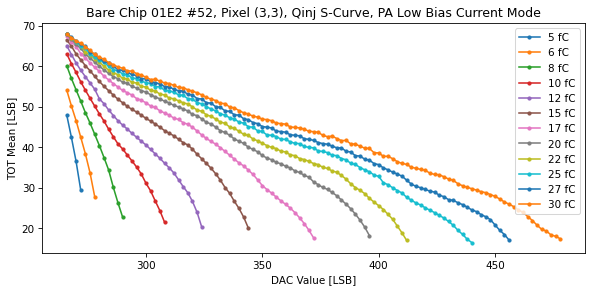

In [106]:
fig = plt.figure(dpi=75, figsize=(8,4))
gs = fig.add_gridspec(len(scan_list),len(scan_list))
u_cl = np.sort(np.unique(col_list))
u_rl = np.sort(np.unique(row_list))
for ri,row in enumerate(u_rl):
    for ci,col in enumerate(u_cl):
        ax0 = fig.add_subplot(gs[len(u_rl)-ri-1,len(u_cl)-ci-1])
        X = []
        Y = []
        for QInj in QInjEns:
            tp_idx = turning_point(np.array(list(hit_counts[(row,col)][QInj].values())), thresholds[QInj])
            ax0.plot(thresholds[QInj][18:tp_idx-0], np.array(list(TOT_mean[(row,col)][QInj].values()))[18:tp_idx-0], '.-', label=f"{QInj} fC")
            X.append(QInj)
            Y.append(thresholds[QInj][tp_idx])
        X = np.array(X)
        Y = np.array(Y)
        ax0.set_xlabel("DAC Value [LSB]")
        ax0.set_ylabel("TOT Mean [LSB]")
        plt.title(f"Bare Chip 01E2 #52, Pixel ({row},{col}), Qinj S-Curve, PA Low Bias Current Mode")
        plt.legend(loc="upper right")
plt.tight_layout()
# plt.savefig("figures/tot_mean_scurve.pdf")
plt.show()

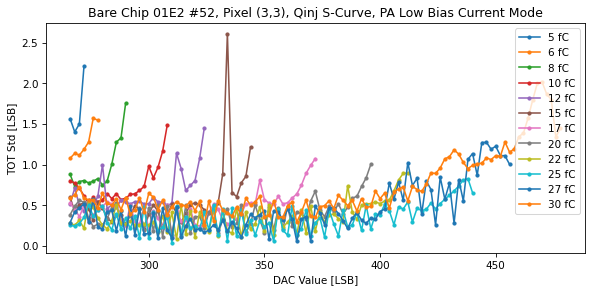

In [107]:
fig = plt.figure(dpi=75, figsize=(8,4))
gs = fig.add_gridspec(len(scan_list),len(scan_list))
u_cl = np.sort(np.unique(col_list))
u_rl = np.sort(np.unique(row_list))
for ri,row in enumerate(u_rl):
    for ci,col in enumerate(u_cl):
        ax0 = fig.add_subplot(gs[len(u_rl)-ri-1,len(u_cl)-ci-1])
        X = []
        Y = []
        for QInj in QInjEns:
            tp_idx = turning_point(np.array(list(hit_counts[(row,col)][QInj].values())), thresholds[QInj])
            ax0.plot(thresholds[QInj][18:tp_idx-0], np.array(list(TOT_std[(row,col)][QInj].values()))[18:tp_idx-0], '.-', label=f"{QInj} fC")
            X.append(QInj)
            Y.append(thresholds[QInj][tp_idx])
        X = np.array(X)
        Y = np.array(Y)
        ax0.set_xlabel("DAC Value [LSB]")
        ax0.set_ylabel("TOT Std [LSB]")
        plt.title(f"Bare Chip 01E2 #52, Pixel ({row},{col}), Qinj S-Curve, PA Low Bias Current Mode")
        plt.legend(loc="upper right")
plt.tight_layout()
# plt.savefig("figures/tot_std_scurve.pdf")
plt.show()

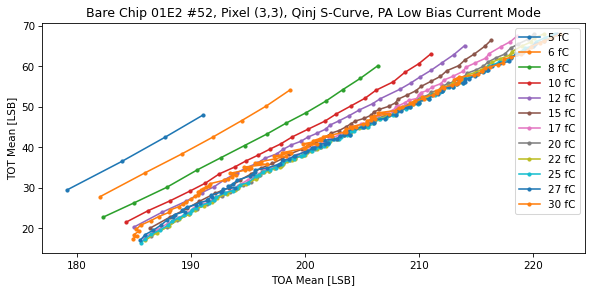

In [108]:
fig = plt.figure(dpi=75, figsize=(8,4))
gs = fig.add_gridspec(len(scan_list),len(scan_list))
u_cl = np.sort(np.unique(col_list))
u_rl = np.sort(np.unique(row_list))
for ri,row in enumerate(u_rl):
    for ci,col in enumerate(u_cl):
        ax0 = fig.add_subplot(gs[len(u_rl)-ri-1,len(u_cl)-ci-1])
        for QInj in QInjEns:
            tp_idx = turning_point(np.array(list(hit_counts[(row,col)][QInj].values())), thresholds[QInj])
            ax0.plot(np.array(list(TOA_mean[(row,col)][QInj].values()))[18:tp_idx-0], np.array(list(TOT_mean[(row,col)][QInj].values()))[18:tp_idx-0], '.-', label=f"{QInj} fC")
        ax0.set_xlabel("TOA Mean [LSB]")
        ax0.set_ylabel("TOT Mean [LSB]")
        plt.title(f"Bare Chip 01E2 #52, Pixel ({row},{col}), Qinj S-Curve, PA Low Bias Current Mode")
        plt.legend(loc="upper right")
plt.tight_layout()
# plt.savefig("figures/toa_mean_vs_tot_mean_scurve.pdf")
plt.show()